#### AML Drug Synergy Analysis

In [1]:
import pandas as pd
import numpy as np
import warnings
import seaborn as sns
import itertools
import pickle
from pathlib import Path
from math import comb
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.patches import Rectangle
from synergy.combination import MuSyC 
from synergy.combination import Loewe 
from synergy.combination import Bliss 
from synergy.combination import CombinationIndex
from synergy.single import Hill
from multiprocessing import Pool

pd.options.display.max_rows = 120
pd.options.display.max_columns = 50
warnings.filterwarnings('ignore')

In [2]:
# Drug names used in all experiments
drugs = ["DAU", "IDA", "Mito", "VP16", "6TG", "2CdA", "FLD", "AraC", "AZC", "DAC", "6MP", "MTX", "AG221", "ABT199","ATRA"]
drugs.sort()
drugs_of_interest = ['AraC','AG221','ABT199','DAU','IDA','Mito','DAC','AZC']
# Local path for the project folder
PROJECT_PATH = Path("/home/wak/toprak-lab/aml_drug_synergy")
# Raw data is located here as a single tab-separated values file
data_path = PROJECT_PATH / "data/raw_curated_single_file/ETECS02-ETECS03-combined-normalized.tsv"
# Parse data into a Pandas dataframe object
raw = pd.read_csv(data_path, sep='\t', dtype={'Conc. A [uM]':float, 'Conc. B [uM]':float, 'Masked':object})
raw

,Index,Plate,Plate ID,Row,Column,Compound A,Conc. A [uM],Compound B,Conc. B [uM],Well Type,Masked,Well Tags,Timestamp,Raw,Normalized,Normalized2,Plate Mask,Cell Line,Cell Line+Well Type
0,1,1,ETECS02 FKH1_1,A,1,ATRA,50.000,ATRA,50.0,Compound,NaN,NaN,13.03.2020 01:48:00,963720.0,-25.443290,0.739827,NaN,FKH1,FKH1 Compound
1,2,1,ETECS02 FKH1_1,A,2,ATRA,5.000,ATRA,50.0,Compound,NaN,NaN,13.03.2020 01:48:00,1300880.0,0.640569,1.006550,NaN,FKH1,FKH1 Compound
2,3,1,ETECS02 FKH1_1,A,3,ATRA,0.500,ATRA,50.0,Compound,NaN,NaN,13.03.2020 01:48:00,1262280.0,-2.345660,0.976014,NaN,FKH1,FKH1 Compound
3,4,1,ETECS02 FKH1_1,A,4,ATRA,0.050,ATRA,50.0,Compound,NaN,NaN,13.03.2020 01:48:00,1277200.0,-1.191397,0.987817,NaN,FKH1,FKH1 Compound
4,5,1,ETECS02 FKH1_1,A,5,ATRA,0.005,ATRA,50.0,Compound,NaN,NaN,13.03.2020 01:48:00,1295760.0,0.244469,1.002500,NaN,FKH1,FKH1 Compound
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123573,9212,24,ETECS03 Kasumi1_24,P,20,NaN,NaN,NaN,NaN,Compound,NaN,NaN,26.04.2021 11:32:29,2774720.0,47.481660,1.483074,NaN,Kasumi1,Kasumi1 Compound
123574,9213,24,ETECS03 Kasumi1_24,P,21,NaN,NaN,NaN,NaN,Compound,NaN,NaN,26.04.2021 11:32:29,2819560.0,49.864990,1.507322,NaN,Kasumi1,Kasumi1 Compound
123575,9214,24,ETECS03 Kasumi1_24,P,22,NaN,NaN,NaN,NaN,Compound,NaN,NaN,26.04.2021 11:32:29,2641640.0,40.408210,1.411109,NaN,Kasumi1,Kasumi1 Compound
123576,9215,24,ETECS03 Kasumi1_24,P,23,NaN,NaN,NaN,NaN,Compound,NaN,NaN,26.04.2021 11:32:29,3013280.0,60.161580,1.612078,NaN,Kasumi1,Kasumi1 Compound


In [3]:
with open(PROJECT_PATH / 'data/raw_effect_matrices/raw_effect_matrices_8x8.pkl', 'rb') as f:
    raw_effect_8 = pickle.load(f)
with open(PROJECT_PATH / 'data/raw_effect_matrices/raw_effect_matrices_11x11.pkl', 'rb') as f:
    raw_effect_11 = pickle.load(f)

In [4]:
np.array(raw_effect_8['FKH1'][('AraC','DAU')].index)
#np.array(raw_effect_8['FKH1'][('AraC','DAU')].columns) / np.array(raw_effect_8['FKH1'][('AraC','DAU')].index)[:,np.newaxis]
aracdau = np.array(raw_effect_8['FKH1'][('AraC','DAU')].index)[:,np.newaxis] / np.array(raw_effect_8['FKH1'][('AraC','DAU')].columns)
#np.savetxt('aracdau.txt', aracdau, fmt='%.5f')
aracdau

array([[           nan, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [           inf, 3.78083496e-02, 1.51233398e-02, 6.04933594e-03,
        2.41973438e-03, 9.67893750e-04, 3.87157500e-04, 1.54863000e-04],
       [           inf, 1.24767090e-01, 4.99068359e-02, 1.99627344e-02,
        7.98509375e-03, 3.19403750e-03, 1.27761500e-03, 5.11046000e-04],
       [           inf, 4.11731689e-01, 1.64692676e-01, 6.58770703e-02,
        2.63508281e-02, 1.05403312e-02, 4.21613250e-03, 1.68645300e-03],
       [           inf, 1.35871460e+00, 5.43485840e-01, 2.17394336e-01,
        8.69577344e-02, 3.47830937e-02, 1.39132375e-02, 5.56529500e-03],
       [           inf, 4.48375732e+00, 1.79350293e+00, 7.17401172e-01,
        2.86960469e-01, 1.14784187e-01, 4.59136750e-02, 1.83654700e-02],
       [           inf, 1.47964014e+01, 5.91856055e+00, 2.36742422e+00,
        9.46969687e-01, 3.78787875e-01, 1.51515150e-01, 6.

In [5]:
def raw_effect_heatmap(cell_line):
    matplotlib.rcParams.update({'font.size': 48})
    # cmap = sns.diverging_palette(220, 20, as_cmap=True)
    cmap = sns.dark_palette("#69d", as_cmap=True)
    df = raw_effect_8[cell_line]
    drugs = ["DAU", "IDA", "Mito", "VP16", "6TG", "2CdA", "FLD", "AraC", "AZC", "DAC", "6MP", "MTX", "AG221", "ABT199","ATRA"]
    fig, axes = plt.subplots(len(drugs), len(drugs), figsize=(75, 76), dpi=300)
    for i1, drug1 in enumerate(drugs):
        for i2, drug2 in enumerate(drugs):
            ax = axes[i1,i2]
            if (drug1,drug2) in df.keys() or (drug2,drug1) in df.keys():
                if (drug1,drug2) in df.keys():
                    dfd = df[(drug1,drug2)]
                else:
                    dfd = df[(drug2,drug1)].T
                sns.heatmap(data=dfd, vmin=0, vmax=1, cmap=cmap, cbar=False, ax=ax)
                ax.set(aspect='equal', xticks=[], yticks=[], xlabel="", ylabel="")
                ax.invert_yaxis()
            else:
                ax.axis('off')
            
            if i1==0:
                ax.set_xlabel(drug2, fontsize=48)
                ax.xaxis.set(label_position='top', ticks_position='top')
            if i2==0:
                ax.set_ylabel(drug1, fontsize=48)
                ax.yaxis.set(label_position='left', ticks_position='left')
            # if i1==len(drugs)-1:
            #     ax.set(xlabel=drug2)#, xticks=0.5+np.arange(len(set(dfd['drug2.conc']))))
            #     # ax.set_xticklabels([str(round(label,2)) for label in sorted(list(set(dfd['drug2.conc'])))], rotation=90)
            #     ax.xaxis.set(label_position='bottom', ticks_position='bottom')
            # if i2==len(drugs)-1:
            #     ax.set(ylabel=drug1)#, yticks=0.5+np.arange(len(set(dfd['drug1.conc']))))
            #     # ax.set_yticklabels([str(round(label,2)) for label in sorted(list(set(dfd['drug1.conc'])))])
            #     ax.yaxis.set(label_position='right', ticks_position='right')
    fig.suptitle(cell_line, fontsize=48)
    fig.patch.set_facecolor('white')
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.05, hspace=0.05)
    fig.savefig(PROJECT_PATH / f'dump/plots/raw_effect_8/raw_effect_8_{cell_line}.png', dpi=300)
    plt.close();
    return cell_line

with Pool(len(raw_effect_8)) as pool:
    for cell_line in pool.imap_unordered(raw_effect_heatmap, raw_effect_8.keys()):
       print(cell_line, " complete.")
#raw_effect_heatmap('FKH1')

NameError: name 'raw_effect_8' is not defined

In [26]:
def synergy_heatmap(cell_line, model='bliss', vmin=-1, vmax=1):
    plt.style.use('default')
    matplotlib.rcParams.update({'font.size': 48})
    cmap = sns.diverging_palette(220, 20, as_cmap=True)

    df = raw_effect_8[cell_line]
    fig, axes = plt.subplots(len(drugs_of_interest), len(drugs_of_interest), figsize=(40, 40), dpi=300)
    for i1, drug1 in enumerate(drugs_of_interest):
        for i2, drug2 in enumerate(drugs_of_interest):
            ax = axes[i1,i2]
            if (drug1,drug2) in df.keys() or (drug2,drug1) in df.keys():
                if (drug1,drug2) in df.keys():
                    singlepair = df[(drug1,drug2)]
                    curr = singlepair.reset_index().melt(id_vars=['Conc. A [uM]']).rename(columns={"value":"effect"}).astype(float)
                    mod = Bliss()
                    mod.fit(d1=curr['Conc. A [uM]'], d2=curr['Conc. B [uM]'], E=curr['effect'])
                else:
                    singlepair = df[(drug2,drug1)].T
                    curr = singlepair.reset_index().melt(id_vars=['Conc. B [uM]']).rename(columns={"value":"effect"}).astype(float)
                    mod = Bliss()
                    mod.fit(d1=curr['Conc. B [uM]'], d2=curr['Conc. A [uM]'], E=curr['effect'])
                    
                const1 = np.log(np.sort(np.unique(mod.d1))[2]/np.sort(np.unique(mod.d1))[1])
                const2 = np.log(np.sort(np.unique(mod.d2))[2]/np.sort(np.unique(mod.d2))[1])
                score = const1*const2*np.nansum(mod.synergy*(1-np.array(curr.effect)))
                
                mod.plot_heatmap(vmin=vmin, vmax=vmax, cmap=cmap, ax=ax)
                D1, D2 = np.meshgrid(mod.d1, mod.d2)

                # Create a formatted annotation matrix
                drug_fc =  np.array(singlepair.columns) / np.array(singlepair.index)[:,np.newaxis] 
                annot_matrix = np.empty(drug_fc.shape, dtype=object)
                for i in range(drug_fc.shape[0]):
                    for j in range(drug_fc.shape[1]):
                        value = drug_fc[i, j]
                        if value >= 1:
                            if value>=1000 and np.isfinite(value):
                                annot_matrix[i, j] = f"{value/1000:.0f}K"
                            else:
                                annot_matrix[i, j] = f"{value:.0f}"
                        else:
                            # Display as 1/decimal
                            if np.isnan(value) or value==0:
                                annot_matrix[i, j] = "0"
                            else:
                                if (1/value)>=1000:
                                    annot_matrix[i, j] = f"1/{int(1 / value)/1000:.0f}K"
                                else:
                                    annot_matrix[i, j] = f"1/{int(1 / value)}"
                        # Calculate the center of each cell
                        ax.text(i+.5, j+.5, annot_matrix[i, j], ha='center', va='center', color='black',fontsize=10,fontweight='bold') # Adjust color as needed

                #ax.set(aspect='equal', xticks=[], yticks=[], xlabel="", ylabel="")
                ax.set(aspect='equal', xscale='linear', yscale='linear', xticks=np.arange(0,8)+0.5, yticks=np.arange(0,8)+.5,
                       xticklabels=[], yticklabels=[], xlabel="", ylabel="")
                ax.collections[-1].colorbar.remove()
                #ax.text(5,0, str(round(score,2)), fontsize=48)
                if i1==0:
                    ax.set_xlabel(drug2, fontsize=48)
                    ax.xaxis.set(label_position='top', ticks_position='top')
                    ax.set_xticklabels(curr['Conc. A [uM]'].unique(), rotation=45)
                    ax.tick_params(axis='x', labelsize=10)  # Set x-axis tick label size
                    for label in ax.get_xticklabels():
                        label.set_weight('bold')
                if i2==0:
                    ax.set_ylabel(drug1, fontsize=48)
                    ax.yaxis.set(label_position='left', ticks_position='left')
                    ax.set_yticklabels([f"{float(lbl):.4f}" for lbl in curr['Conc. B [uM]'].unique()])
                    ax.tick_params(axis='y', labelsize=10)  # Set y-axis tick label size
                    for label in ax.get_yticklabels():
                        label.set_weight('bold')
            else:
                ax.axis('off')
    fig.suptitle(cell_line, fontsize=48)
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.05, hspace=0.05)
    fig.savefig(PROJECT_PATH / f'dump/plots/bliss_2d_8/doi-{cell_line}.png', dpi=300)
    plt.close();
    return cell_line

In [27]:
with Pool(len(raw_effect_8)) as pool:
    for cell_line in pool.imap_unordered(synergy_heatmap, raw_effect_8.keys()):
       print(cell_line, " complete.")

Kasumi1  complete.
K562  complete.
IDH2  complete.
HL60  complete.
TF1  complete.
FKH1  complete.


In [24]:
synergy_heatmap('FKH1')

'FKH1'

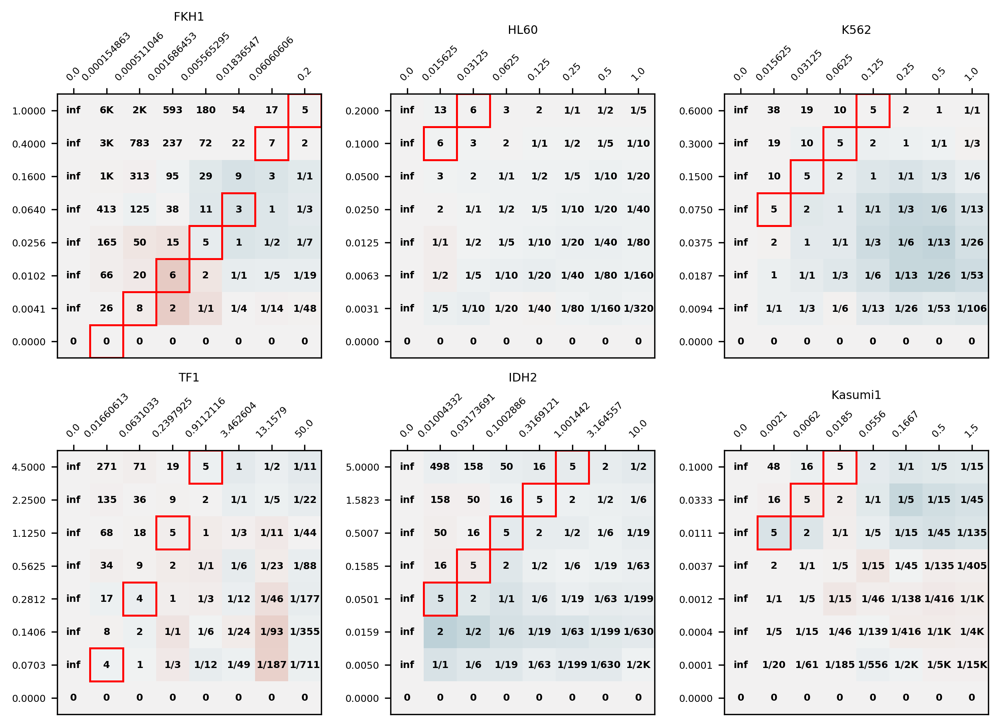

In [5]:
import matplotlib.patches as patches
# colors and fonts
cmap = sns.diverging_palette(220, 20, as_cmap=True)
matplotlib.rcParams.update({'font.size': 6})
# figure dimensions
fig, axes = plt.subplots(2, 3, figsize=(9,6), dpi=300)
# axes per cell line
for axi, cell_line in enumerate(raw_effect_8.keys()):
    df = raw_effect_8[cell_line]
    ax = axes.flat[axi]
    drug1 = 'AraC'
    drug2 = 'DAU'
    singlepair = df[(drug1,drug2)]
    curr = singlepair.reset_index().melt(id_vars=['Conc. A [uM]']).rename(columns={"value":"effect"}).astype(float)
    mod = Bliss()
    mod.fit(d1=curr['Conc. A [uM]'], d2=curr['Conc. B [uM]'], E=curr['effect'])
    const1 = np.log(np.sort(np.unique(mod.d1))[2]/np.sort(np.unique(mod.d1))[1])
    const2 = np.log(np.sort(np.unique(mod.d2))[2]/np.sort(np.unique(mod.d2))[1])
    score = const1*const2*np.nansum(mod.synergy*(1-np.array(curr.effect)))
    
    mod.plot_heatmap(vmin=-1, vmax=1, cmap=cmap, ax=ax)
    D1, D2 = np.meshgrid(mod.d1, mod.d2)

    # Create a formatted annotation matrix
    drug_fc =  np.array(singlepair.columns) / np.array(singlepair.index)[:,np.newaxis] 
    annot_matrix = np.empty(drug_fc.shape, dtype=object)
    prev_minj = -1
    for i in range(drug_fc.shape[0]):
        # find the square closest to N
        minj = np.argmin(abs(drug_fc[i,:]-5))
        if i>0 and minj != prev_minj:
            # Create a square (Rectangle with equal width and height)
            square = patches.Rectangle((i, minj), 1, 1, fill=False, edgecolor='red', linewidth=1.2)
            # Add the square to the plot
            ax.add_patch(square)
            prev_minj = minj
        for j in range(drug_fc.shape[1]):
            value = drug_fc[i, j]
            if value >= 1:
                if value>=1000 and np.isfinite(value):
                    annot_matrix[i, j] = f"{value/1000:.0f}K"
                else:
                    annot_matrix[i, j] = f"{value:.0f}"
            else:
                # Display as 1/decimal
                if np.isnan(value) or value==0:
                    annot_matrix[i, j] = "0"
                else:
                    if (1/value)>=1000:
                        annot_matrix[i, j] = f"1/{int(1 / value)/1000:.0f}K"
                    else:
                        annot_matrix[i, j] = f"1/{int(1 / value)}"
            # Calculate the center of each cell
            ax.text(i+.5, j+.5, annot_matrix[i, j], ha='center', va='center', color='black',fontsize=6,fontweight='bold') # Adjust color as needed

        ax.set(aspect='equal', xscale='linear', yscale='linear', xticks=np.arange(0,8)+0.5, yticks=np.arange(0,8)+.5,
            xlabel="", ylabel="")
        ax.set_xticklabels(curr['Conc. A [uM]'].unique(), rotation=45)
        ax.set_yticklabels([f"{float(lbl):.4f}" for lbl in curr['Conc. B [uM]'].unique()])

        colorbar = ax.collections[0].colorbar
        if colorbar:
            colorbar.remove()
        #ax.text(5,0, str(round(score,2)), fontsize=48)
        # ax.set_xlabel(drug2)
        ax.xaxis.set(label_position='top', ticks_position='top')
        # ax.set_ylabel(drug1)
        ax.yaxis.set(label_position='left', ticks_position='left')
        #print(ax.collections[0])
        ax.set_title(cell_line)
        # Get the offset text object and adjust its position
        offset_text = ax.yaxis.get_offset_text()
        offset_text.set_horizontalalignment('left')
        offset_text.set_position((-.15,1))

plt.tight_layout()
plt.subplots_adjust(wspace=0.05, hspace=0.35)
plt.savefig(PROJECT_PATH / 'dump/figures/Figure 5. AraC vs DAU synergy per drug conc.png', dpi=300, bbox_inches='tight')

In [66]:
with Pool(len(raw_effect_8)) as pool:
    for cell_line in pool.imap_unordered(synergy_heatmap, raw_effect_8.keys()):
       print(cell_line, " complete.")
#raw_effect_heatmap('FKH1')

Kasumi1  complete.
K562  complete.
HL60  complete.
IDH2  complete.
TF1  complete.
FKH1  complete.


#### Plot single drug response curves

In [41]:
def single_drug_response(cell_line, datasets):
    plt.style.use('default')

    single_drc = []
    df = datasets[cell_line]
    fig, axes = plt.subplots(4,4, figsize=(12,12), dpi=150)
    drugs = ["DAU", "IDA", "Mito", "VP16", "6TG", "2CdA", "FLD", "AraC", "AZC", "DAC", "6MP", "MTX", "AG221", "ABT199","ATRA"]

    for i1, drug1 in enumerate(drugs):
        ax = axes.flat[i1]
        for i2, drug2 in enumerate(drugs):
            select_drug_pair = ((df['drug1']==drug1) & (df['drug2.conc']<1e-7)) & ((df['drug2']==drug2))
            select_drug_pair2 = ((df['drug2']==drug1) & (df['drug1.conc']<1e-7)) & ((df['drug1']==drug2))
            if sum(select_drug_pair)>0:
                dfd = df[select_drug_pair]
                ax.plot(dfd['drug1.conc'], dfd['effect'])
                single_drc.append({
                 'cell_line':cell_line, 'drug1':drug1, 'drug2':drug2,
                 'drug1.conc': dfd['drug1.conc'].values, 'effect': dfd['effect'].values
                 })
            if sum(select_drug_pair2)>0:
                dfd2 = df[select_drug_pair2]
                ax.plot(dfd2['drug2.conc'], dfd2['effect'])
                single_drc.append({
                 'cell_line':cell_line, 'drug1':drug1, 'drug2':drug2,
                 'drug1.conc': dfd2['drug2.conc'].values, 'effect': dfd2['effect'].values
                 })
        ax.set_ylim([0,1])
        ax.set_title(drug1)
    fig.suptitle(cell_line)
    plt.tight_layout()
    fig.savefig(f'dump/plots/8x8-single-drug/single-drug-response-{cell_line}.png', dpi=300)
    plt.close();
    return single_drc

single_drc_df = []
for cell_line in datasets.keys():
    single_drc = single_drug_response(cell_line, datasets)
    single_drc_df.extend(single_drc)

single_drc_11_df = []
for cell_line in datasets11.keys():
    single_drc = single_drug_response(cell_line, datasets11)
    single_drc_11_df.extend(single_drc)

single_drc_df = pd.DataFrame(single_drc_df)
single_drc11_df = pd.DataFrame(single_drc_11_df)
single_drc_df['drug1.N'] = single_drc_df['drug1.conc'].apply(len)
single_drc_df

,cell_line,drug1,drug2,drug1.conc,effect,drug1.N
0,FKH1,DAU,DAU,"[1.0, 0.4, 0.16, 0.064, 0.0256, 0.01024, 0.004...","[0.0, 0.0, 0.1822285, 0.1698042, 0.3261733, 0....",8
1,FKH1,DAU,DAU,"[1.0, 0.4, 0.16, 0.064, 0.0256, 0.01024, 0.004...","[0.0, 0.0, 0.1840343, 0.2054602, 0.3365764, 0....",8
2,FKH1,DAU,IDA,"[1.0, 0.4, 0.16, 0.064, 0.0256, 0.01024, 0.004...","[0.0, 0.0, 0.2012386, 0.2089552, 0.3165804, 0....",8
3,FKH1,DAU,Mito,"[1.0, 0.4, 0.16, 0.064, 0.0256, 0.01024, 0.004...","[0.0, 0.0, 0.1697054, 0.2070116, 0.2961286, 0....",8
4,FKH1,DAU,VP16,"[1.0, 0.4, 0.16, 0.064, 0.0256, 0.01024, 0.004...","[0.0, 0.0, 0.1459526, 0.1898287, 0.2822704, 0....",8
...,...,...,...,...,...,...
1405,TF1,ATRA,MTX,"[50.0, 16.66667, 5.555555, 1.851852, 0.6172839...","[0.504749, 0.6929817, 0.6355152, 0.7118307, 0....",8
1406,TF1,ATRA,AG221,"[50.0, 16.66667, 5.555555, 1.851852, 0.6172839...","[0.6084924, 0.7949117, 0.7655271, 0.7813326, 0...",8
1407,TF1,ATRA,ABT199,"[50.0, 16.66667, 5.555555, 1.851852, 0.6172839...","[0.6526457, 0.7282739, 0.6881655, 0.7042088, 0...",8
1408,TF1,ATRA,ATRA,"[50.0, 16.66667, 5.555555, 1.851852, 0.6172839...","[0.6719512, 0.7353656, 0.754092, 0.8004114, 0....",8


In [39]:
single_drc11_df['drug1.N'] = single_drc11_df['drug1.conc'].apply(len)
single_drc11_df#.to_csv('test11.tsv', sep='\t')

,cell_line,drug1,drug2,drug1.conc,effect,drug1.N
0,HL60,IDA,IDA,"[0.003, 0.002307692, 0.001775148, 0.001365498,...","[0.2088277, 0.3918261, 0.6458662, 0.68509, 0.7...",22
1,HL60,IDA,IDA,"[0.003, 0.002307692, 0.001775148, 0.001365498,...","[0.4369471, 0.4216782, 0.6818442, 0.7340968, 0...",22
2,HL60,IDA,2CdA,"[0.003, 0.002307692, 0.001775148, 0.001365498,...","[0.4191485, 0.4645343, 0.5760968, 0.5417765, 0...",22
3,HL60,IDA,FLD,"[0.003, 0.002307692, 0.001775148, 0.001365498,...","[0.4271521, 0.4954885, 0.6046364, 0.6380312, 0...",22
4,HL60,2CdA,IDA,"[0.055, 0.04583333, 0.03819444, 0.03182871, 0....","[0.0710612, 0.1054679, 0.1609682, 0.2961314, 0...",22
5,HL60,2CdA,2CdA,"[0.055, 0.04583333, 0.03819444, 0.03182871, 0....","[0.0604723, 0.0905155, 0.1406591, 0.2325033, 0...",22
6,HL60,2CdA,2CdA,"[0.055, 0.04583333, 0.03819444, 0.03182871, 0....","[0.0561865, 0.113273, 0.1548022, 0.2489606, 0....",22
7,HL60,2CdA,FLD,"[0.055, 0.04583333, 0.03819444, 0.03182871, 0....","[0.0812189, 0.115496, 0.2014264, 0.3550465, 0....",22
8,HL60,2CdA,AG221,"[0.055, 0.04583333, 0.03819444, 0.03182871, 0....","[0.0864898, 0.1486026, 0.241348, 0.357865, 0.5...",22
9,HL60,FLD,IDA,"[5.0, 4.0, 3.2, 2.56, 2.048, 1.6384, 1.31072, ...","[0.0813454, 0.1613818, 0.5380054, 0.6361275, 0...",22


#### Find consensus single drug response curves from all plates

In [24]:
df = single_drc11_df
df[(df['cell_line']=='FKH1') & (df['drug1']=='IDA')]['effect'].apply(len)

78    33
79    33
Name: effect, dtype: int64

In [5]:
df[(df['cell_line']=='K562') & (df['drug1']=='FLD')].to_csv('test.csv')

In [35]:
def calculate_median_single_drc(df):
    median_single_drug_effect = df.groupby(['cell_line', 'drug1'])['effect'].agg(
        lambda x: np.array([np.median([xx[i] for xx in x]) for i in range(min(x.apply(len)))])).to_frame()
    median_single_drug_conc = df.groupby(['cell_line', 'drug1'])['drug1.conc'].agg(
        lambda x: np.array(x.iloc[0])).to_frame()
    median_single_drug = pd.merge(median_single_drug_conc, median_single_drug_effect, left_index=True, right_index=True)
    return median_single_drug
median_single_drug = calculate_median_single_drc(single_drc_df)
median_single_drug11 = calculate_median_single_drc(single_drc11_df)
median_single_drug

drug1.conc  \
cell_line drug1                                                       
FKH1      2CdA    [0.2, 0.1333333, 0.08888889, 0.05925926, 0.039...   
          6MP     [50.0, 5.0, 0.5, 0.05, 0.005, 0.0005, 5e-05, 0.0]   
          6TG     [50.0, 31.25, 19.53125, 12.20703, 7.629395, 4....   
          ABT199  [1.0, 0.3125, 0.09765625, 0.03051758, 0.009536...   
          AG221   [50.0, 25.0, 12.5, 6.25, 3.125, 1.5625, 0.7812...   
          ATRA    [50.0, 5.0, 0.5, 0.05, 0.005, 0.0005, 5e-05, 0.0]   
          AZC     [50.0, 25.0, 12.5, 6.25, 3.125, 1.5625, 0.7812...   
          AraC    [0.2, 0.06060606, 0.01836547, 0.005565295, 0.0...   
          DAC     [50.0, 22.72727, 10.33058, 4.695717, 2.134417,...   
          DAU     [1.0, 0.4, 0.16, 0.064, 0.0256, 0.01024, 0.004...   
          FLD      [20.0, 10.0, 5.0, 2.5, 1.25, 0.625, 0.3125, 0.0]   
          IDA     [0.2, 0.06666667, 0.02222222, 0.007407407, 0.0...   
          MTX     [50.0, 15.15152, 4.591368, 1.391324, 0.4216132...   
          Mito    [0.05, 0.02, 0.008, 0.0032, 0.00128, 0.000512,...   
          VP16    [50.0, 16.66667, 5.555555, 1.851852, 0.6172839...   
HL60      2CdA    [0.1, 0.06666667, 0.04444445, 0.02962963, 0.01...   
          6MP     [50.0, 15.81139, 5.0, 1.581139, 0.5, 0.1581139...   
          6TG     [10.0, 7.518797, 5.653231, 4.250549, 3.195902,...   
          ABT199   [50.0, 10.0, 2.0, 0.4, 0.08, 0.016, 0.0032, 0.0]   
          AG221   [50.0, 33.33333, 22.22222, 14.81481, 9.876543,...   
          ATRA    [50.0, 5.0, 0.5, 0.05, 0.005, 0.0005, 5e-05, 0.0]   
          AZC      [20.0, 10.0, 5.0, 2.5, 1.25, 0.625, 0.3125, 0.0]   
          AraC    [1.0, 0.5, 0.25, 0.125, 0.0625, 0.03125, 0.015...   
          DAC     [50.0, 12.5, 3.125, 0.78125, 0.1953125, 0.0488...   
          DAU     [0.2, 0.1, 0.05, 0.025, 0.0125, 0.00625, 0.003...   
          FLD     [10.0, 6.666667, 4.444445, 2.962963, 1.975309,...   
          IDA     [0.005, 0.003333333, 0.002222222, 0.001481481,...   
          MTX     [25.0, 12.5, 6.25, 3.125, 1.5625, 0.78125, 0.3...   
          Mito    [0.025, 0.0125, 0.00625, 0.003125, 0.0015625, ...   
          VP16       [4.0, 2.0, 1.0, 0.5, 0.25, 0.125, 0.0625, 0.0]   
Idh2mut   2CdA    [0.5, 0.2777778, 0.154321, 0.08573388, 0.04762...   
          6MP     [5.0, 2.777778, 1.54321, 0.8573388, 0.4762993,...   
          6TG      [50.0, 20.0, 8.0, 3.2, 1.28, 0.512, 0.2048, 0.0]   
          ABT199  [25.0, 16.66667, 11.11111, 7.407407, 4.938272,...   
          AG221   [50.0, 33.33333, 22.22222, 14.81481, 9.876543,...   
          AZC     [50.0, 31.25, 19.53125, 12.20703, 7.629395, 4....   
          AraC    [10.0, 3.164557, 1.001442, 0.3169121, 0.100288...   
          DAC     [50.0, 20.83333, 8.680555, 3.616898, 1.507041,...   
          DAU     [5.0, 1.582278, 0.500721, 0.158456, 0.05014431...   
          FLD     [20.0, 12.5, 7.8125, 4.882812, 3.051758, 1.907...   
          IDA     [1.0, 0.3164557, 0.1001442, 0.0316912, 0.01002...   
          MTX     [1.0, 0.25, 0.0625, 0.015625, 0.00390625, 0.00...   
          Mito    [1.5, 0.4285714, 0.122449, 0.03498542, 0.00999...   
          VP16    [50.0, 16.66667, 5.555555, 1.851852, 0.6172839...   
K562      2CdA    [25.0, 8.333333, 2.777778, 0.9259259, 0.308642...   
          6MP     [0.5, 0.3846154, 0.295858, 0.2275831, 0.175063...   
          6TG      [50.0, 20.0, 8.0, 3.2, 1.28, 0.512, 0.2048, 0.0]   
          ABT199  [20.0, 15.38461, 11.83432, 9.103323, 7.002556,...   
          AG221   [50.0, 40.0, 32.0, 25.6, 20.48, 16.384, 13.107...   
          ATRA    [50.0, 38.46154, 29.5858, 22.75831, 17.50639, ...   
          AZC      [50.0, 20.0, 8.0, 3.2, 1.28, 0.512, 0.2048, 0.0]   
          AraC    [1.0, 0.5, 0.25, 0.125, 0.0625, 0.03125, 0.015...   
          DAC     [50.0, 15.15152, 4.591368, 1.391324, 0.4216132...   
          DAU     [0.6, 0.3, 0.15, 0.075, 0.0375, 0.01875, 0.009...   
          FLD     [50.0, 35.71429, 25.5102, 18.22157, 13.01541, ...   
          

In [26]:
median_single_drug11.head()

drug1.conc  \
cell_line drug1                                                      
FKH1      2CdA   [0.13, 0.09285714, 0.07142857, 0.05494506, 0.0...   
          AG221  [50.0, 38.46154, 29.5858, 22.75831, 17.50639, ...   
          AZC    [50.0, 31.25, 19.53125, 12.20703, 7.629395, 4....   
          DAC    [50.0, 27.77778, 15.4321, 8.573388, 4.762993, ...   
          FLD    [10.0, 5.882353, 3.460208, 2.035416, 1.197304,...   

                                                            effect  
cell_line drug1                                                     
FKH1      2CdA   [0.0700156, 0.0681908, 0.0644762, 0.1339053, 0...  
          AG221  [0.090556, 0.2506958, 0.3445107, 0.3744323, 0....  
          AZC    [0.0570674, 0.1101239, 0.20877335, 0.34098295,...  
          DAC    [0.5434835, 0.7709361, 1.0, 1.0, 1.0, 0.972437...  
          FLD    [0.0402576, 0.0432888, 0.0490117, 0.0781472, 0...

##### Plot consensus single drug response curves

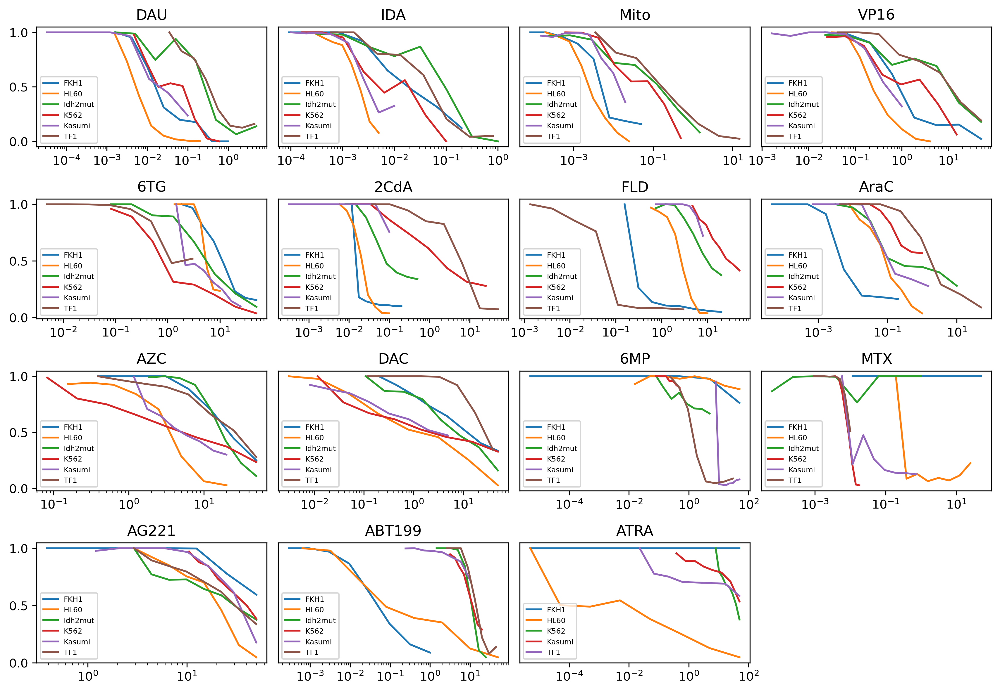

In [30]:
def plot_consensus_single_drcs(datasets, median_single_drug):
    fig, axes = plt.subplots(4,4, figsize=(11.5,8), dpi=300)
    plt.style.use('default')
    matplotlib.rcParams.update({'font.size': 10})

    for i1, drug1 in enumerate(drugs):        
        for cell_line in datasets.keys():
            ax = axes.flat[i1]
            if (cell_line, drug1) in median_single_drug.index:
                x = np.array(median_single_drug.loc[(cell_line, drug1), 'drug1.conc'])
                if x[-1]<1e-7:
                    x[-1]=x[-2]/(x[0]/x[1])
                y = median_single_drug.loc[(cell_line, drug1), 'effect']

                ax.plot(x, y, label=cell_line)
                ax.set_xscale('log')
                ax.set_title(drug1)
                ax.legend(loc='lower left', prop={'size': 6})
                if i1%4!=0:
                    ax.set_yticks([])
    axes[3,3].set_axis_off()
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.05)

plot_consensus_single_drcs(datasets, median_single_drug)

ValueError: x and y must have same first dimension, but have shapes (21,) and (18,)

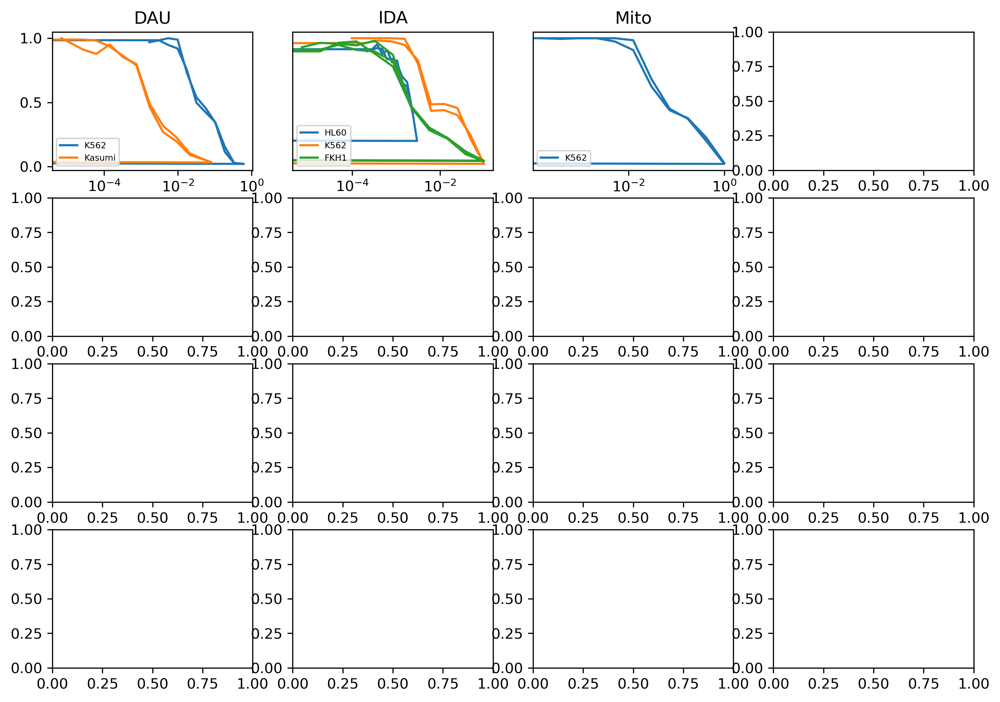

In [31]:
plot_consensus_single_drcs(datasets11, median_single_drug11)

##### Hill fit for consensus single drug response curves

In [8]:
for cell_line in datasets:
    single_lineData={}
    single_lineData_clean={}
    for drug in drugs:
        E0=[]; Emax=[]; h=[]; c=[]; data=None; in11=False
        if (cell_line, drug) in median_single_drug.index:
            drug_conc = np.array(median_single_drug.loc[(cell_line,drug), 'drug1.conc'])
            effect = np.array(median_single_drug.loc[(cell_line,drug), 'effect'])
            effect[effect<0] = 0
            effect[effect>1] = 1
            modelH = Hill(E0_bounds=(0,1), Emax_bounds=(0,1))
            modelH.fit(drug_conc, effect, bootstrap_iterations=50)
            if modelH.converged:
                median_single_drug.loc[(cell_line, drug), 'E0'] = modelH.E0
                median_single_drug.loc[(cell_line, drug), 'Emax'] = modelH.Emax
                median_single_drug.loc[(cell_line, drug), 'h'] = modelH.h
                median_single_drug.loc[(cell_line, drug), 'c'] = modelH.C
                median_single_drug.loc[(cell_line, drug), 'r2'] = modelH.r_squared
                median_single_drug.loc[(cell_line, drug), 'modelH'] = modelH
median_single_drug.head(3)

drug1.conc  \
cell_line drug1                                                      
FKH1      2CdA   [0.2, 0.1333333, 0.08888889, 0.05925926, 0.039...   
          6MP    [50.0, 5.0, 0.5, 0.05, 0.005, 0.0005, 5e-05, 0.0]   
          6TG    [50.0, 31.25, 19.53125, 12.20703, 7.629395, 4....   

                                                            effect   E0  \
cell_line drug1                                                           
FKH1      2CdA   [0.09440055, 0.09285215, 0.10160985, 0.1020053...  1.0   
          6MP    [0.8348433, 0.9854407905, 1.0, 1.0, 1.0, 1.0, ...  1.0   
          6TG    [0.1548059, 0.1730159, 0.23093550000000002, 0....  1.0   

                     Emax         h         c        r2  \
cell_line drug1                                           
FKH1      2CdA   0.091636  1.562589  0.003903  0.999966   
          6MP    0.834798  4.572093  8.335425  1.000000   
          6TG    0.120052  2.258107  9.453608  0.994815   

                                                       modelH  
cell_line drug1                                                
FKH1      2CdA   Hill(E0=1.00, Emax=0.09, h=1.56, C=3.90e-03)  
          6MP    Hill(E0=1.00, Emax=0.83, h=4.57, C=8.34e+00)  
          6TG    Hill(E0=1.00, Emax=0.12, h=2.26, C=9.45e+00)

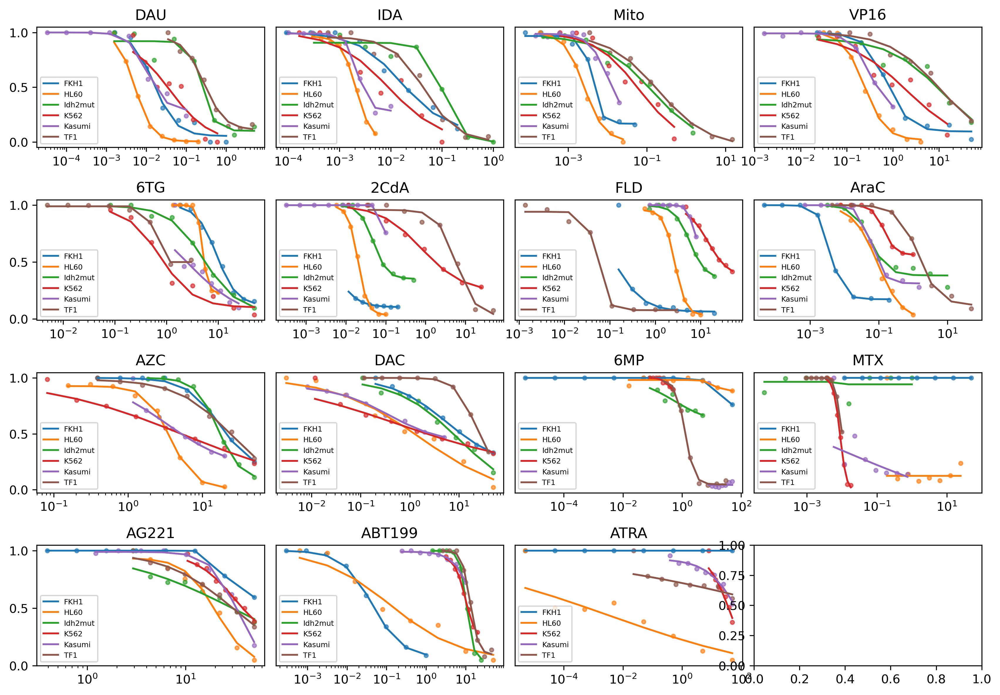

In [10]:
fig, axes = plt.subplots(4,4, figsize=(11.5,8), dpi=300)
palette = sns.color_palette("tab10")
for i1, drug1 in enumerate(drugs):        
    for ci, cell_line in enumerate(datasets.keys()):
        ax = axes.flat[i1]
        if (cell_line, drug1) in median_single_drug_conc.index:
            x = np.array(median_single_drug_conc.loc[(cell_line, drug1), 'drug1.conc'])
            if x[-1]<1e-7:
                x[-1]=x[-2]/(x[0]/x[1])
            y = median_single_drug_effect.loc[(cell_line, drug1), 'effect']
            # plot raw data as scatter plot
            ax.scatter(x, y, color=palette[ci], alpha=0.66, s=10)
            # find global range over all cell lines
            l = median_single_drug_conc.xs(drug1, level=1)['drug1.conc'].values
            flat_list = [item for sublist in l for item in sublist]
            glob_x = np.linspace(min(flat_list), max(flat_list), 10)
            #print(min(glob_x), max(glob_x))
            # plot hill function fit over
            ax.plot(x, median_single_drug.loc[(cell_line, drug1), 'modelH'].E(x), color=palette[ci], label=cell_line)
            ax.set_xscale('log')
            ax.set_title(drug1)
            ax.legend(loc='lower left', prop={'size': 6})
            if i1%4!=0:
                ax.set_yticks([])
plt.tight_layout()
plt.subplots_adjust(wspace=0.05)

#### Cross out plates that fails to capture median drug response curve

In [34]:
df = datasets['K562']
df8 = df.groupby(['line','drug1','drug2']).agg(list)
df8 = df8.apply(lambda x: np.array(x))
print(type(df8.iloc[0,0]))
df8.head()

<class 'list'>


drug1.conc  \
line drug1 drug2                                                       
K562 2CdA  2CdA    [25.0, 8.333333, 2.777778, 0.9259259, 0.308642...   
           6MP     [25.0, 8.333333, 2.777778, 0.9259259, 0.308642...   
           6TG     [25.0, 8.333333, 2.777778, 0.9259259, 0.308642...   
           ABT199  [25.0, 8.333333, 2.777778, 0.9259259, 0.308642...   
           AG221   [25.0, 8.333333, 2.777778, 0.9259259, 0.308642...   

                                                          drug2.conc  \
line drug1 drug2                                                       
K562 2CdA  2CdA    [25.0, 25.0, 25.0, 25.0, 25.0, 25.0, 25.0, 25....   
           6MP     [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.384...   
           6TG     [50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50....   
           ABT199  [20.0, 20.0, 20.0, 20.0, 20.0, 20.0, 20.0, 20....   
           AG221   [50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50.0, 50....   

                                                              effect  
line drug1 drug2                                                      
K562 2CdA  2CdA    [0.1910645, 0.1936199, 0.205155, 0.2326915, 0....  
           6MP     [0.2867421, 0.3583981, 0.462332, 0.6866257, 0....  
           6TG     [0.0442064, 0.0469897, 0.0445681, 0.0420993, 0...  
           ABT199  [0.1291283, 0.1482024, 0.1721278, 0.2223843, 0...  
           AG221   [0.090516, 0.0765602, 0.0830703, 0.083141, 0.2...

In [ ]:
df8.loc[('K562','AG221','MTX'), 'effect.conc']

In [ ]:
median_single_drug.head()

drug1.conc  \
cell_line drug1                                                       
FKH1      2CdA    [0.2, 0.1333333, 0.08888889, 0.05925926, 0.039...   
          6MP     [50.0, 5.0, 0.5, 0.05, 0.005, 0.0005, 5e-05, 0.0]   
          6TG     [50.0, 31.25, 19.53125, 12.20703, 7.629395, 4....   
          ABT199  [1.0, 0.3125, 0.09765625, 0.03051758, 0.009536...   
          AG221   [50.0, 25.0, 12.5, 6.25, 3.125, 1.5625, 0.7812...   

                                                             effect   E0  \
cell_line drug1                                                            
FKH1      2CdA    [0.09440055, 0.09285215, 0.10160985, 0.1020053...  1.0   
          6MP     [0.8348433, 0.9854407905, 1.0, 1.0, 1.0, 1.0, ...  1.0   
          6TG     [0.1548059, 0.1730159, 0.23093550000000002, 0....  1.0   
          ABT199  [0.04290695, 0.1193042, 0.3067333, 0.59089585,...  1.0   
          AG221   [0.5947462, 0.78037155, 0.997778214, 1.0, 1.0,...  1.0   

                      Emax         h          c        r2  \
cell_line drug1                                             
FKH1      2CdA    0.091636  1.562589   0.003903  0.999966   
          6MP     0.834798  4.572093   8.335425  1.000000   
          6TG     0.120052  2.258107   9.453608  0.994815   
          ABT199  0.024610  1.150125   0.042807  0.999380   
          AG221   0.593129  7.739030  24.489925  1.000000   

                                                        modelH  
cell_line drug1                                                 
FKH1      2CdA    Hill(E0=1.00, Emax=0.09, h=1.56, C=3.90e-03)  
          6MP     Hill(E0=1.00, Emax=0.83, h=4.57, C=8.34e+00)  
          6TG     Hill(E0=1.00, Emax=0.12, h=2.26, C=9.45e+00)  
          ABT199  Hill(E0=1.00, Emax=0.02, h=1.15, C=4.28e-02)  
          AG221   Hill(E0=1.00, Emax=0.59, h=7.74, C=2.45e+01)

: 

In [30]:
from sklearn.metrics import mean_squared_error
def mfc(predictions, targets):
    return np.nanmedian(np.abs(np.log(predictions / targets)))

def squared_sum_dist(predictions, targets):
    return np.sum((predictions-targets)**2)

def is_single_drc_valid(cell_line, drug, drug_conc, effect):
    pass

def single_drc_validation(cell_line, model='bliss', drug=1, vmin=-1, vmax=1):
    plt.style.use('default')
    matplotlib.rcParams.update({'font.size': 48})
    cmap = sns.diverging_palette(220, 20, as_cmap=True)

    all_rmse = []
    df = datasets[cell_line]
    df8 = df.groupby(['line','drug1','drug2']).agg(list)
    fig, axes = plt.subplots(len(drugs), len(drugs), figsize=(75, 75), dpi=300)
    for i1, drug1 in enumerate(drugs):
        for i2, drug2 in enumerate(drugs):
            ax = axes[i1,i2]
            if (cell_line, drug1, drug2) in df8.index:
                plate = df8.loc[(cell_line, drug1, drug2), :]
            if (cell_line, drug2, drug1) in df8.index:
                plate = df8.loc[(cell_line, drug2, drug1), :]
    
            if model=='loewe':
                mod = Loewe(E0_bounds=[0,1], E1_bounds=[0,1], E2_bounds=[0,1])
                mod.fit(d1=plate['drug2.conc'], d2=plate['drug1.conc'], E=plate['effect'])
                score = np.nanmedian(mod.synergy)
            elif model=='bliss':
                mod = Bliss()
                mod.fit(d1=plate['drug2.conc'], d2=plate['drug1.conc'], E=plate['effect'])
                const1 = np.log(np.sort(np.unique(mod.d1))[2]/np.sort(np.unique(mod.d1))[1])
                const2 = np.log(np.sort(np.unique(mod.d2))[2]/np.sort(np.unique(mod.d2))[1])
                score = const1*const2*np.nansum(mod.synergy*(1-np.array(plate['effect'][::-1])))
            
            single_drug1 = np.array(plate['drug2.conc'])<1e-7
            single_drug2 = np.array(plate['drug1.conc'])<1e-7
            if drug==1:
                ax.plot(np.array(plate['drug1.conc'])[single_drug1], np.array(plate['effect'])[single_drug1])
                ax.plot(median_single_drug.loc[(cell_line,drug1),'drug1.conc'], median_single_drug.loc[(cell_line,drug1),'effect'])
                rmse = squared_sum_dist(median_single_drug.loc[(cell_line,drug1),'effect'], np.array(plate['effect'])[single_drug1])
                mean_fold_change = mfc(median_single_drug.loc[(cell_line,drug1),'effect'], np.array(plate['effect'])[single_drug1])
            elif drug==2:
                ax.plot(np.array(plate['drug2.conc'])[single_drug2], np.array(plate['effect'])[single_drug2])
                ax.plot(median_single_drug.loc[(cell_line,drug2),'drug1.conc'], median_single_drug.loc[(cell_line,drug2),'effect'])
                rmse = squared_sum_dist(median_single_drug.loc[(cell_line,drug2),'effect'], np.array(plate['effect'])[single_drug2])
                mean_fold_change = mfc(median_single_drug.loc[(cell_line,drug2),'effect'], np.array(plate['effect'])[single_drug2])

            all_rmse.append(rmse)
            ax.text(0.5,0.5,"%.3f"%rmse, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)
            ax.set(xscale='log', xticks=[], yticks=[], xticklabels=[], yticklabels=[], xlabel="", ylabel="", ylim=[0,1])
            ## check if plate is valid
            # if not is_single_drc_valid(cell_line, drug1, plate.loc[single_drug1,'drug1.conc'], plate.loc[single_drug1,'effect']) or \
            #    not is_single_drc_valid(cell_line, drug2, plate.loc[single_drug2,'drug2.conc'], plate.loc[single_drug2,'effect']):
            #     ax.text(5,5, "INVALID", color='red', fontsize=48)
            if i1==0:
                ax.set_xlabel(drug2, fontsize=48)
                ax.xaxis.set(label_position='top')#, ticks_position='top')
            if i2==0:
                ax.set_ylabel(drug1, fontsize=48)
                ax.yaxis.set(label_position='left')#, ticks_position='left')
    fig.suptitle(cell_line, fontsize=48)
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.05, hspace=0.05)
    #fig.savefig(f'dump/plots/8x8-{model}-heatmap-{cell_line}.png', dpi=300)
    return all_rmse

In [31]:
all_rmse = single_drc_validation('K562', drug=1)

'K562'

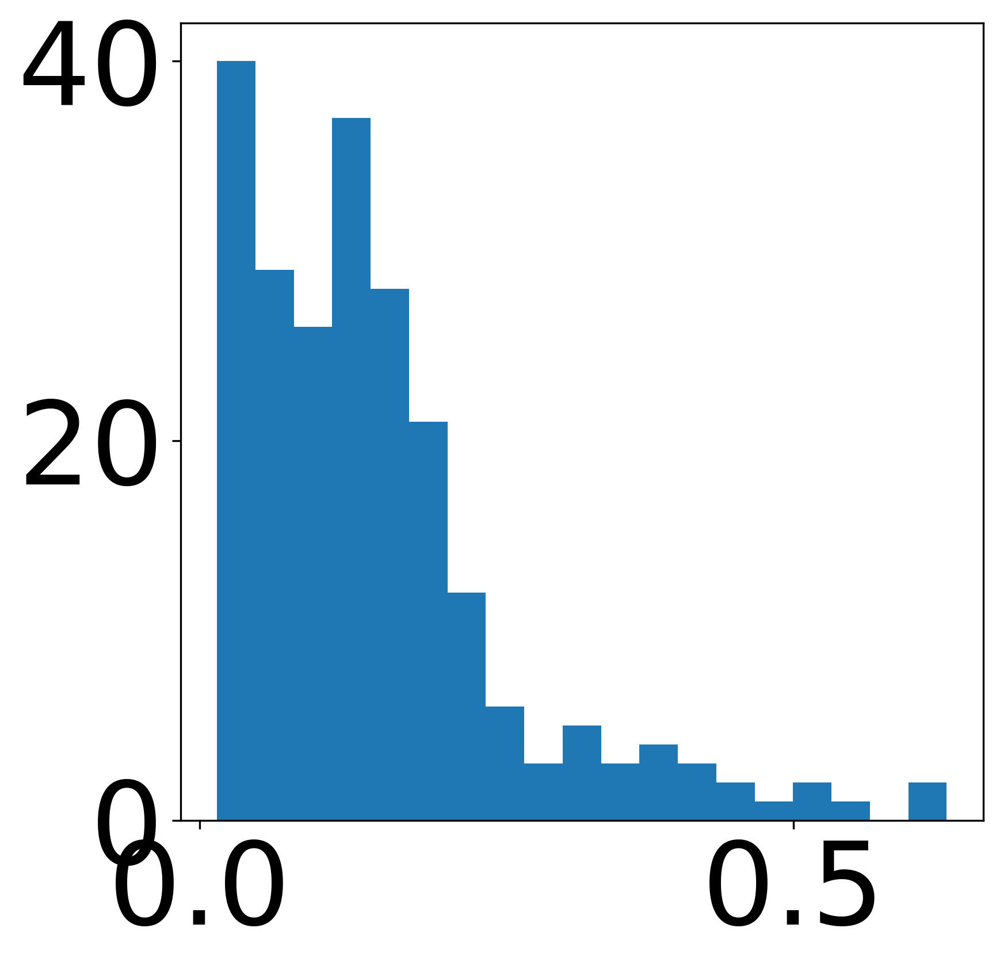

: 

: 

: 

In [ ]:
single_drc_validation('K562', drug=2)

In [ ]:
def is_single_drc_valid(cell_line, drug, drug_conc, effect):
    pass

def single_drc_validation(cell_line, model='bliss', drug=1, vmin=-1, vmax=1):
    plt.style.use('default')
    matplotlib.rcParams.update({'font.size': 48})
    cmap = sns.diverging_palette(220, 20, as_cmap=True)

    df = datasets[cell_line]
    df8 = df.groupby(['line','drug1','drug2']).agg(list)
    fig, axes = plt.subplots(len(drugs), len(drugs), figsize=(75, 75), dpi=300)
    for i1, drug1 in enumerate(drugs):
        for i2, drug2 in enumerate(drugs):
            ax = axes[i1,i2]
            if (cell_line, drug1, drug2) in df8.index:
                plate = df8.loc[(cell_line, drug1, drug2), :]
            if (cell_line, drug2, drug1) in df8.index:
                plate = df8.loc[(cell_line, drug2, drug1), :]
    
            if model=='loewe':
                mod = Loewe(E0_bounds=[0,1], E1_bounds=[0,1], E2_bounds=[0,1])
                mod.fit(d1=plate['drug2.conc'], d2=plate['drug1.conc'], E=plate['effect'])
                score = np.nanmedian(mod.synergy)
            elif model=='bliss':
                mod = Bliss()
                mod.fit(d1=plate['drug2.conc'], d2=plate['drug1.conc'], E=plate['effect'])
                const1 = np.log(np.sort(np.unique(mod.d1))[2]/np.sort(np.unique(mod.d1))[1])
                const2 = np.log(np.sort(np.unique(mod.d2))[2]/np.sort(np.unique(mod.d2))[1])
                score = const1*const2*np.nansum(mod.synergy*(1-np.array(plate['effect'][::-1])))
            
            single_drug1 = np.array(plate['drug2.conc'])<1e-7
            single_drug2 = np.array(plate['drug1.conc'])<1e-7
            if drug==1:
                ax.plot(np.array(plate['drug1.conc'])[single_drug1], np.array(plate['effect'])[single_drug1])
                ax.plot(median_single_drug.loc[(cell_line,drug1),'drug1.conc'], median_single_drug.loc[(cell_line,drug1),'effect'])
            elif drug==2:
                ax.plot(np.array(plate['drug2.conc'])[single_drug2], np.array(plate['effect'])[single_drug2])
                ax.plot(median_single_drug.loc[(cell_line,drug2),'drug1.conc'], median_single_drug.loc[(cell_line,drug2),'effect'])
            ax.set(xscale='log', xticks=[], yticks=[], xticklabels=[], yticklabels=[], xlabel="", ylabel="")
            ## check if plate is valid
            # if not is_single_drc_valid(cell_line, drug1, plate.loc[single_drug1,'drug1.conc'], plate.loc[single_drug1,'effect']) or \
            #    not is_single_drc_valid(cell_line, drug2, plate.loc[single_drug2,'drug2.conc'], plate.loc[single_drug2,'effect']):
            #     ax.text(5,5, "INVALID", color='red', fontsize=48)
            if i1==0:
                ax.set_xlabel(drug2, fontsize=48)
                ax.xaxis.set(label_position='top')#, ticks_position='top')
            if i2==0:
                ax.set_ylabel(drug1, fontsize=48)
                ax.yaxis.set(label_position='left')#, ticks_position='left')
    fig.suptitle(cell_line, fontsize=48)
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.05, hspace=0.05)
    #fig.savefig(f'dump/plots/8x8-{model}-heatmap-{cell_line}.png', dpi=300)
    return cell_line